In [1]:
import os
import numpy as np
import os
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal

from matplotlib.backends.backend_pdf import PdfPages


In [2]:
import sys
sys.path.append('/Users/hamzaabdelhedi/Projects/enhancing_plt_utils/')
from enhancing_plt_utils import plt_enhancing
from color_maps import continuous_color_map, autumn, one_piece, oppenheimer, the_blues, green_bull, pink_ocean, spring, grey

In [3]:
path = "/Users/hamzaabdelhedi/Projects/data/MFRS_data/"
rdms_folder = os.path.join(path, "networks_rdms")
plots_folder = os.path.join(path, "plots")
subjects_dir = os.path.join(path, "subjects")
similarity_folder = os.path.join(path, "similarity_scores")

In [4]:
import matplotlib.style as style 
plt_enhancing(font_size=18, line_width=2.5, marker_size=10, marker_edge_width=2.5, line_width_global=2.5, patch_line_width=2.5, xtick_major_size=5.0, ytick_major_size=5.0, xtick_major_width=2.0, ytick_major_width=2.0, xtick_label_size="xx-large", ytick_label_size="xx-large", label_size="x-large", title_size="x-large", figure_title_size="xx-large", legend_size="large", figure_title_weight="bold", cap_size=4, dashed_pattern=[8.0, 4.0], savefig_format="svg", savefig_bbox="tight", spines_right=False, spines_top=False, auto_layout=True)
style.use('fivethirtyeight')

# Printing all layers sim values for all analysis

In [5]:
import mne
from matplotlib import colormaps
from mne.viz import Brain
cmap= colormaps["bwr"]
rois = mne.read_labels_from_annot(parc='aparc_sub', subject='fsaverage', subjects_dir=subjects_dir)

Reading labels from parcellation...
   read 226 labels from /Users/hamzaabdelhedi/Projects/data/MFRS_data/subjects/fsaverage/label/lh.aparc_sub.annot
   read 224 labels from /Users/hamzaabdelhedi/Projects/data/MFRS_data/subjects/fsaverage/label/rh.aparc_sub.annot


In [6]:
# Sampling frequency
total_time_ms = 1000
num_values = 1101

time_values = np.linspace(-200, total_time_ms - 200, num_values)


In [7]:
main_region = "occipital"
fusiform_labels = [i for i, label in enumerate(rois) if main_region in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]
model_layes = 404
model = "FaceNet"

In [8]:
smoothing = "not_smoothed"
# Create a PDF file to save the plots
activation_types = ["trained", "imagenet", "untrained", "imagenet"]
ann_analysis_types = ["with-meg_pretrained", "meg_stimuli_faces", "None", "None"]
for stimuli_type in ["fam", "unfamiliar", "scrambled"]:
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activation_types):
        pdf_pages = PdfPages(f"{plots_folder}/across_time/{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}_rdm_plots_{main_region}_{smoothing}.pdf")
        if not os.path.exists(f"{plots_folder}/across_time/{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}_rdm_plots_{main_region}_{smoothing}.pdf"):
                
            try:
                for k in range(model_layes):
                    left = 0
                    right = 0
                    fig, axs = plt.subplots(figsize=(70, 20), nrows=1, ncols=2)
                    for i, roi in enumerate(region_name):
                        folder = os.path.join(similarity_folder, f"{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}")
                        file_path = os.path.join(folder, f"raw_{model}_{ann_analysis_type}_{roi}_rdm_{activation_type}_{stimuli_type}.npy")
                        file = np.load(file_path)
                        window_size = 5
                        smoothed_values = scipy.signal.savgol_filter(file[0,:,k,0], window_size, 4)
                        if roi[-3:] == "-lh":
                            axs[0].plot(time_values, smoothed_values, label=roi, color=oppenheimer[left])
                            left += 1
                        else:
                            axs[1].plot(time_values, smoothed_values, label=roi, color=the_blues[right])
                            right += 1

                    # Set title, x-axis label, y-axis label, x-axis limits, y-axis limits, and grid for both subplots
                    for ax in axs.flatten():
                        ax.set_title("Left Hemisphere" if ax == axs[0] else "Right Hemisphere", fontsize=50)
                        ax.set_xlabel("Time (ms)", fontsize=50)
                        ax.set_ylabel("Similarity Score", fontsize=50)
                        ax.set_xlim(-200, 800)
                        ax.set_ylim(-0.18, 0.18)
                        ax.grid(True, alpha=0.5)
                        ax.axvline(x=0, color='k'  if ax == axs[0] else 'r', linestyle='--', label="Onset of Stimulus")

                    # Add legend to both subplots
                    axs[0].legend()
                    axs[1].legend()

                    fig.suptitle(f"Similarity Scores for {model} {ann_analysis_type} {activation_type} {stimuli_type} for the {k}th Layer", fontsize=50)

                    # Save the plot in a PDF file
                    pdf_pages.savefig(fig)

                    # Clear the figure for the next row
                    plt.clf()

                print(f"PDF file for {model}_{ann_analysis_type}_{activation_type}_{stimuli_type} has been saved.")

                # Close the PDF file
                pdf_pages.close()

            except Exception as e:
                print(f"An error occurred: {e}")
        else:
            print(f"PDF file for {model}_{ann_analysis_type}_{activation_type}_{stimuli_type} already exists.")

PDF file for FaceNet_with-meg_pretrained_trained_fam already exists.
PDF file for FaceNet_meg_stimuli_faces_imagenet_fam already exists.
PDF file for FaceNet_None_untrained_fam already exists.
PDF file for FaceNet_None_imagenet_fam already exists.
PDF file for FaceNet_with-meg_pretrained_trained_unfamiliar already exists.
PDF file for FaceNet_meg_stimuli_faces_imagenet_unfamiliar already exists.
PDF file for FaceNet_None_untrained_unfamiliar already exists.
PDF file for FaceNet_None_imagenet_unfamiliar already exists.
PDF file for FaceNet_with-meg_pretrained_trained_scrambled already exists.
PDF file for FaceNet_meg_stimuli_faces_imagenet_scrambled already exists.
PDF file for FaceNet_None_untrained_scrambled already exists.
PDF file for FaceNet_None_imagenet_scrambled already exists.


In [186]:
main_region = "fusiform"
fusiform_labels = [i for i, label in enumerate(rois) if main_region in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]
model_layes = 404
model = "FaceNet"

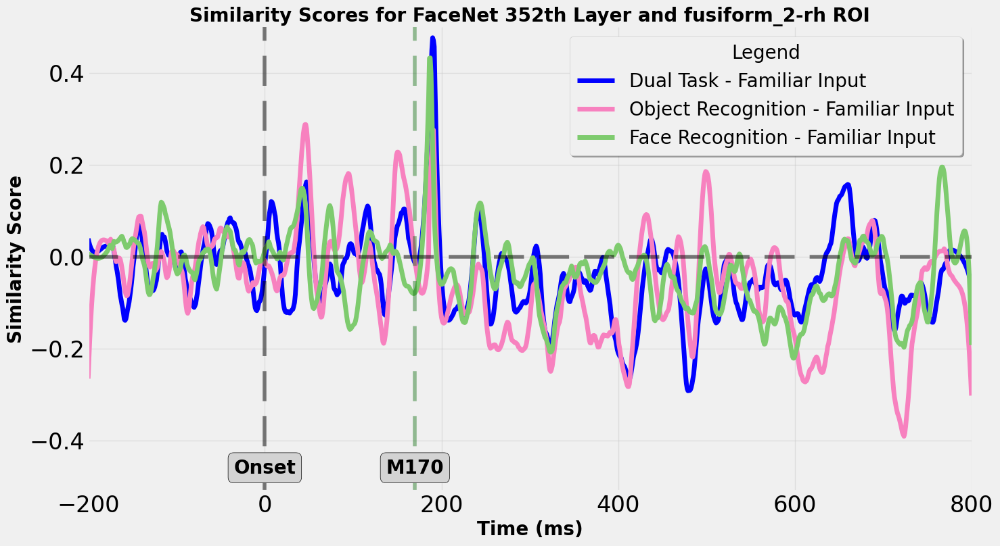

In [10]:

smoothing = "not_smoothed"
activation_types = [ "imagenet",  "imagenet", "trained",]
ann_analysis_types = [ "meg_stimuli_faces", "None", "with-meg_pretrained", ]
labels = ["Dual Task - Familiar Input", "Object Recognition - Familiar Input", "Face Recognition - Familiar Input",]
stimuli_type = "fam"
k = 352
i = 3

colors = [ spring[1], pink_ocean[-6], green_bull[4], grey[2], ]
roi = region_name[i]
fig, axs = plt.subplots(figsize=(15, 8), nrows=1, ncols=1)
for ann_analysis_type, activation_type, color, label in zip(ann_analysis_types, activation_types, colors, labels):
    folder = os.path.join(similarity_folder, f"{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}")
    file_path = os.path.join(folder, f"raw_{model}_{ann_analysis_type}_{roi}_rdm_{activation_type}_{stimuli_type}.npy")
    file = np.load(file_path)
    noise_ceiling = np.load(os.path.join(similarity_folder, "noise_ceiling", f"{roi}_{stimuli_type}_upper_noise_ceiling.npy"))
    noise_ceiling = np.squeeze(noise_ceiling)
    # Get the values from file[0,:,k,0]
    file[file[:, :, :, 1] > 0.05] = 0
    values = file[0,:,k,0]
    window_size = 30 

    # Create a mask for values between 170 and 200
    values = file[0,:,k,0]
    values = values / noise_ceiling
    # Create an array to store the smoothed values
    smoothed_values = np.zeros_like(values)

    # Smooth values with indices between 170 and 200
    smoothed_values[425:431] = scipy.signal.savgol_filter(values[425:431], 6, 4)

    # Assign a value of 50 to the rest of the values
    smoothed_values[:425] = scipy.signal.savgol_filter(values[:425], 50, 4)
    smoothed_values[431:] = scipy.signal.savgol_filter(values[431:], 50, 4)
    axs.plot(time_values, smoothed_values, label=label, color=color, linewidth=5)

axs.set_xlabel("Time (ms)", fontsize=20, fontweight='bold')
axs.set_ylabel("Similarity Score", fontsize=20, fontweight='bold')
axs.set_xlim(-200, 800)
axs.set_ylim(-0.51, 0.5)
axs.grid(True, alpha=0.5)
axs.axvline(x=0, color='k', linestyle='--', alpha=0.5)
axs.axhline(y=0, color='k',  alpha=0.5, linestyle="--")
axs.axvline(x=170, color=one_piece[-3], alpha=0.4, linestyle="--")

bbox_props = dict(boxstyle="round, pad=0.3", edgecolor="black", facecolor="lightgrey")
axs.text(.2, 0.05, "Onset", fontsize=20, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)
axs.text(.370, 0.05, "M170", fontsize=20, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)

axs.legend(loc='upper right', title="Legend", fontsize=20, title_fontsize=20, shadow=True, fancybox=True)
fig.tight_layout()
axs.set_title(f"Similarity Scores for {model} {k}th Layer and {roi} ROI", fontsize=20, fontweight='bold')
# Save the plot in a  png file
# plt.savefig(f"{plots_folder}/final/{model}_{stimuli_type}_rdm_plots_{main_region}.png")
plt.show()


Text(0.5, 1.0, 'Similarity Scores for FaceNet 195th Layer and lateraloccipital_2-rh ROI')

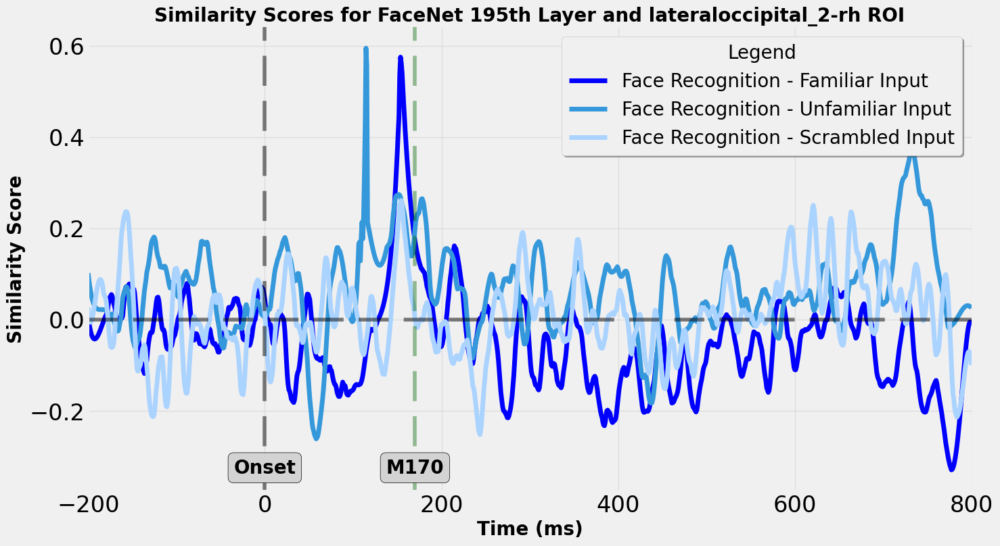

In [224]:
fig
smoothing = "not_smoothed"
# Create a PDF file to save the plots
activation_types = [ "imagenet",  "imagenet", "trained",]
ann_analysis_types = [ "meg_stimuli_faces", "None", "with-meg_pretrained", ]
labels = ["Dual Task - Familiar Input", "Object Recognition - Familiar Input", "Face Recognition - Familiar Input",]
stimuli_type = "fam"
k = 195
i = 6

colors = [ spring[1], the_blues[5], the_blues[8],  grey[2], ]
roi = region_name[i]
fig, axs = plt.subplots(figsize=(15, 8), nrows=1, ncols=1)

for stimuli_type, color, label in zip(["fam", "unfamiliar", "scrambled"], colors, ["Face Recognition - Familiar Input", "Face Recognition - Unfamiliar Input", "Face Recognition - Scrambled Input"]):
    folder = os.path.join(similarity_folder, f"{model}_with-meg_pretrained_trained_{stimuli_type}")
    file_path = os.path.join(folder, f"raw_{model}_with-meg_pretrained_{roi}_rdm_trained_{stimuli_type}.npy")
    file = np.load(file_path)
    file[file[:, :, :, 1] > 0.05] = 0
    noise_ceiling = np.load(os.path.join(similarity_folder, "noise_ceiling", f"{roi}_{stimuli_type}_upper_noise_ceiling.npy"))
    noise_ceiling = np.squeeze(noise_ceiling)
    # Get the values from file[0,:,k,0]
    values = file[0,:,k,0]
    window_size = 35

    # Create a mask for values between 170 and 200
    values = file[0,:,k,0]
    values = values / noise_ceiling
    # Create an array to store the smoothed values
    smoothed_values = np.zeros_like(values)
    if label == "Face Recognition - Familiar Input":
    # Smooth values with indices between 170 and 200
        smoothed_values[387:391] = values[387:391]

        # Assign a value of 50 to the rest of the values
        smoothed_values[:387] = scipy.signal.savgol_filter(values[:387], 50, 4)
        smoothed_values[391:] = scipy.signal.savgol_filter(values[391:], 50, 4)
    elif label == "Face Recognition - Unfamiliar Input":
        smoothed_values[338:348] = values[338:348]

        # Assign a value of 50 to the rest of the values
        smoothed_values[:338] = scipy.signal.savgol_filter(values[:338], 50, 4)
        smoothed_values[348:] = scipy.signal.savgol_filter(values[348:], 50, 4)
    else:
        smoothed_values = scipy.signal.savgol_filter(values, window_size, 4)
    axs.plot(time_values, smoothed_values, label=label, color=color, linewidth=5)

    # for ax in axs.flatten():
    #     ax.set_title("Left Hemisphere" if ax == axs[0] else "Right Hemisphere", fontsize=50)
axs.set_xlabel("Time (ms)", fontsize=20, fontweight='bold')
axs.set_ylabel("Similarity Score", fontsize=20, fontweight='bold')
axs.set_xlim(-200, 800)
# axs.set_ylim(-0.51, 0.5)
axs.grid(True, alpha=0.5)
axs.axvline(x=0, color='k', linestyle='--', alpha=0.5)
axs.axhline(y=0, color='k',  alpha=0.5, linestyle="--")
axs.axvline(x=170, color=one_piece[-3], alpha=0.4, linestyle="--")

bbox_props = dict(boxstyle="round, pad=0.3", edgecolor="black", facecolor="lightgrey")
axs.text(.2, 0.05, "Onset", fontsize=20, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)
axs.text(.370, 0.05, "M170", fontsize=20, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)

axs.legend(loc='upper right', title="Legend", fontsize=20, title_fontsize=20, shadow=True, fancybox=True)
fig.tight_layout()
axs.set_title(f"Similarity Scores for {model} {k}th Layer and {roi} ROI", fontsize=20, fontweight='bold')

# Save the plot in a  png file
# plt.savefig(f"{plots_folder}/final/Inputs_{model}_{stimuli_type}_rdm_plots_{main_region}.png")

In [179]:
main_region = "inferiortemporal"
fusiform_labels = [i for i, label in enumerate(rois) if main_region in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]
model_layes = 404
model = "FaceNet"

(1, 1101, 404, 2)
(1, 1101, 404, 2)
(1, 1101, 404, 2)


Text(0.5, 1.0, 'Similarity Scores for FaceNet 195th Layer and lateraloccipital_2-rh ROI')

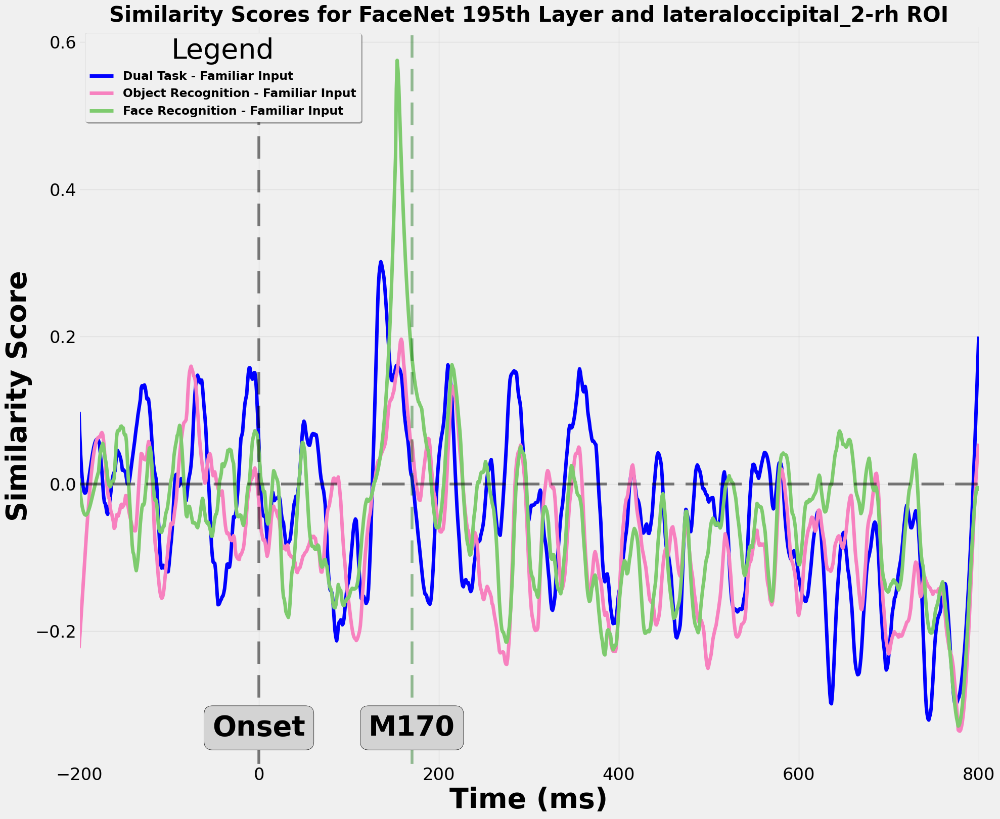

In [226]:
fig
# Create a PDF file to save the plots
activation_types = [ "imagenet",  "imagenet", "trained",]
ann_analysis_types = [ "meg_stimuli_faces", "None", "with-meg_pretrained", ]
labels = ["Dual Task - Familiar Input", "Object Recognition - Familiar Input", "Face Recognition - Familiar Input",]
stimuli_type = "fam"
k = 195
i = 6

colors = [ spring[1], pink_ocean[-6], green_bull[4], grey[2], ]
roi = region_name[i]
fig, axs = plt.subplots(figsize=(20, 16), nrows=1, ncols=1)
for ann_analysis_type, activation_type, color, label in zip(ann_analysis_types, activation_types, colors, labels):
    folder = os.path.join(similarity_folder, f"{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}")
    file_path = os.path.join(folder, f"raw_{model}_{ann_analysis_type}_{roi}_rdm_{activation_type}_{stimuli_type}.npy")
    file = np.load(file_path)
    print(file.shape)
    file[file[:, :, :, 1] > 0.05] = 0
    # Get the values from file[0,:,k,0]
    values = file[0,:,k,0]

    window_size = 30 if label == "Face Recognition" else 50
    noise_ceiling = np.load(os.path.join(similarity_folder, "noise_ceiling", f"{roi}_{stimuli_type}_upper_noise_ceiling.npy"))
    noise_ceiling = np.squeeze(noise_ceiling)
    # Create a mask for values between 170 and 200
    values = file[0,:,k,0]
    values = values / noise_ceiling
    # Create an array to store the smoothed values
    smoothed_values = np.zeros_like(values)
    if label == "Face Recognition - Familiar Input":
        # Smooth values with indices between 170 and 200
        smoothed_values[387:391] = values[387:391]

        # Assign a value of 50 to the rest of the values
        smoothed_values[:387] = scipy.signal.savgol_filter(values[:387], 50, 4)
        smoothed_values[391:] = scipy.signal.savgol_filter(values[391:], 50, 4)
    else:
        smoothed_values = scipy.signal.savgol_filter(values, 50, 4)
    # Smooth values with indices between 170 and 200
    # smoothed_values[387:391] = values[387:391]

    # # # Assign a value of 50 to the rest of the values
    # smoothed_values[:387] = scipy.signal.savgol_filter(values[:387], 50, 4)
    # smoothed_values[391:] = scipy.signal.savgol_filter(values[391:], 50, 4)
    # smoothed_values = scipy.signal.savgol_filter(values, window_size, 4)
    # smoothed_values = values
    axs.plot(time_values, smoothed_values, label=label, color=color, linewidth=5)

axs.set_xlabel("Time (ms)", fontsize=40, fontweight='bold')
axs.set_ylabel("Similarity Score", fontsize=40, fontweight='bold')
axs.set_xlim(-200, 800)
# axs.set_ylim(-0.15, 0.15)
axs.grid(True, alpha=0.5)
axs.axvline(x=0, color='k', linestyle='--', alpha=0.5)
axs.axhline(y=0, color='k',  alpha=0.5, linestyle="--")
axs.axvline(x=170, color=one_piece[-3], alpha=0.4, linestyle="--")

bbox_props = dict(boxstyle="round, pad=0.3", edgecolor="black", facecolor="lightgrey")
axs.text(.2, 0.05, "Onset", fontsize=40, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)
axs.text(.370, 0.05, "M170", fontsize=40, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)

axs.legend(loc='upper left', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
fig.tight_layout()
axs.set_title(f"Similarity Scores for {model} {k}th Layer and {roi} ROI", fontsize=30, fontweight='bold')

# Save the plot in a  png file
# plt.savefig(f"{plots_folder}/final/{model}_{stimuli_type}_rdm_plots_{main_region}.png")

In [192]:
main_region = "occipital"
fusiform_labels = [i for i, label in enumerate(rois) if main_region in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]
model_layes = 404
model = "FaceNet"

In [193]:
from scipy.ndimage import gaussian_filter


(404, 1101)
region lateraloccipital_1-lh max intensity: 0.5242990654385811 at layer 367
(404, 1101)
region lateraloccipital_1-rh max intensity: 0.5385674459455283 at layer 230
(404, 1101)
region lateraloccipital_10-lh max intensity: 0.6416927819954236 at layer 6
(404, 1101)
region lateraloccipital_10-rh max intensity: 0.45948528851197223 at layer 359
(404, 1101)
region lateraloccipital_11-lh max intensity: 0.46638031353671905 at layer 317
(404, 1101)
region lateraloccipital_2-lh max intensity: 0.47073485069360493 at layer 4
(404, 1101)
region lateraloccipital_2-rh max intensity: 0.5753009749390258 at layer 195
(404, 1101)
region lateraloccipital_3-lh max intensity: 0.4800627859235428 at layer 4
(404, 1101)
region lateraloccipital_3-rh max intensity: 0.6019371610660839 at layer 4
(404, 1101)
region lateraloccipital_4-lh max intensity: 0.7139077218761961 at layer 3
(404, 1101)
region lateraloccipital_4-rh max intensity: 0.48249741645295924 at layer 48
(404, 1101)
region lateraloccipital_

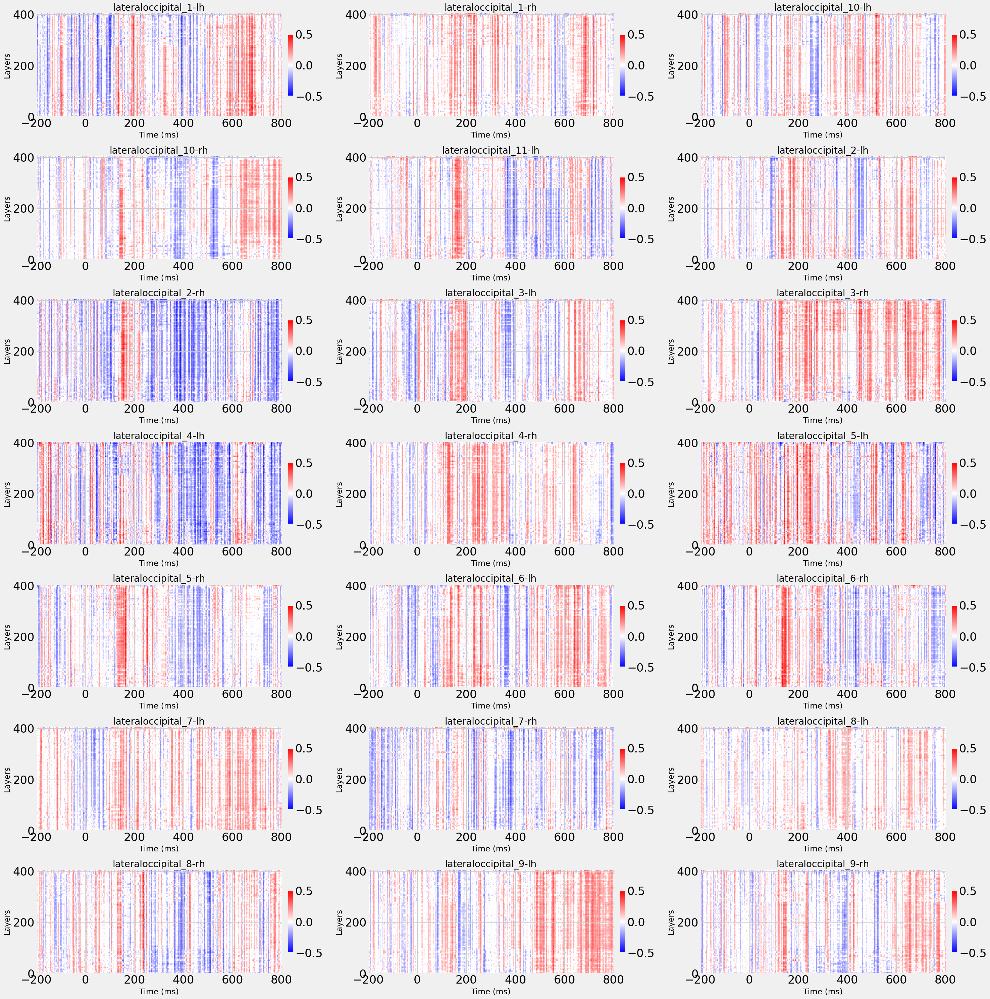

In [194]:
# Define subplot layout
num_rows = 7  # Number of rows of subplots (adjust as needed)
num_cols = 3  # Number of columns of subplots (adjust as needed)
total_subplots = num_rows * num_cols

# Create a figure and subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(30, 30))
# Define the x-axis values from -200 to 800 with 1101 time points
x_values = np.linspace(-200, 800, 1101)

# Create an empty list to store the maximum intensity values for all subplots
global_max_intensity = 0
stimuli_type = "fam"
activation_type = "trained"
for i, roi in enumerate(region_name):
    if i >= total_subplots:
        break  # Break loop if we reach the total number of subplots
    
    folder = os.path.join(similarity_folder, f"{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}")
    file_path = os.path.join(folder, f"raw_{model}_{ann_analysis_type}_{roi}_rdm_{activation_type}_{stimuli_type}.npy")
    noise_ceiling = np.load(os.path.join(similarity_folder, "noise_ceiling", f"{roi}_{stimuli_type}_upper_noise_ceiling.npy"))
    
    file = np.load(file_path)
    file[file[:, :, :, 1] > 0.05] = 0
    file = np.squeeze(file)
    file = file[:, :, 0]
    file = np.transpose(file)
    file = file / noise_ceiling
    
    # Apply Gaussian filter for smoothing
    
    row = i // num_cols  # Calculate row index
    col = i % num_cols   # Calculate column index
    # Plot on the corresponding subplot
    print(file.shape)
    im = axs[row, col].imshow(file, cmap="bwr", aspect="auto", extent=[-200, 800, 0, 404], vmin=-0.5, vmax=0.5)
    axs[row, col].set_title(roi)
    axs[row, col].set_xlabel('Time (ms)')
    axs[row, col].set_ylabel('Layers')
    cbar = fig.colorbar(im, ax=axs[row, col], orientation='vertical', shrink=0.6, aspect=10, pad=0.02,)
    # Store the maximum intensity value for this subplot
    max_intensity_layer = np.unravel_index(np.argmax(file), file.shape)[0]  # Get the index of the max value
    print(f"region {roi} max intensity: {np.max(file)} at layer {max_intensity_layer}")
# Get the maximum intensity value across all subplots
# Set the same color limits for all subplots

# Create a single colorbar for the entire figure
# cbar = fig.colorbar(orientation='vertical', shrink=0.6, aspect=10, pad=0.02)
# cbar.set_label('Intensity', rotation=270, labelpad=15)

# Adjust layout
plt.tight_layout()
plt.show()


In [38]:
print(data.shape)

(404, 1101)


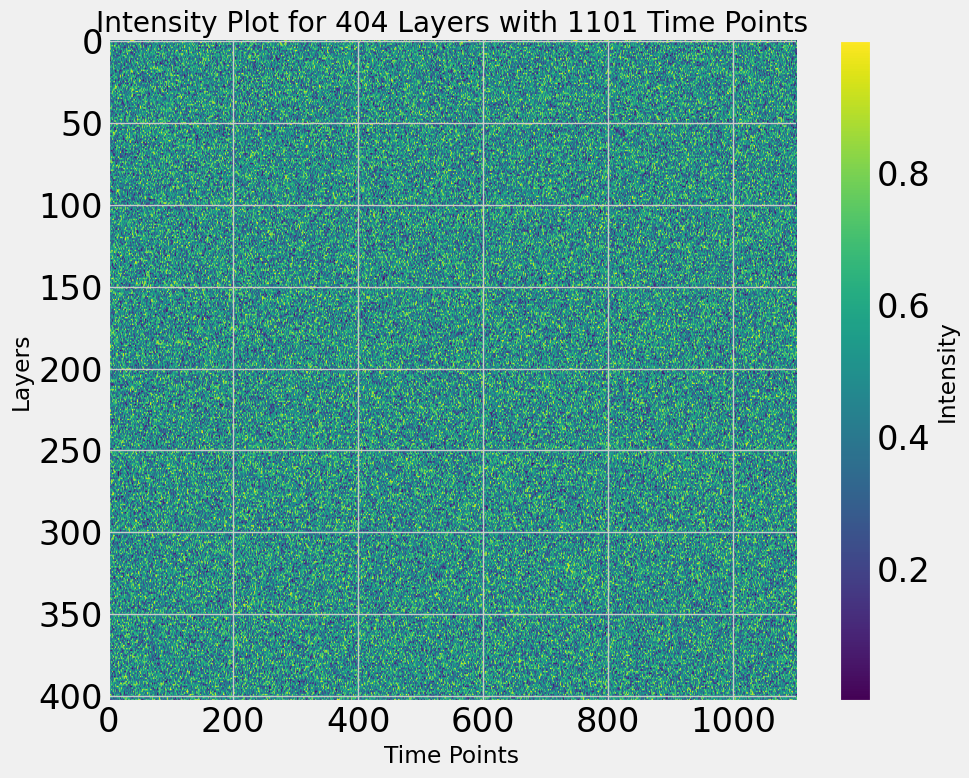

In [34]:
import numpy as np
import matplotlib.pyplot as plt

# Generate random data for 404 layers and 1101 time points
num_layers = 404
num_time_points = 1101

data = np.random.rand(num_layers, num_time_points)

# Create a heatmap
plt.figure(figsize=(10, 8))
plt.imshow(data, aspect='auto', cmap='viridis')  # 'viridis' is the colormap for intensity
plt.colorbar(label='Intensity')
plt.xlabel('Time Points')
plt.ylabel('Layers')
plt.title('Intensity Plot for 404 Layers with 1101 Time Points')
plt.show()


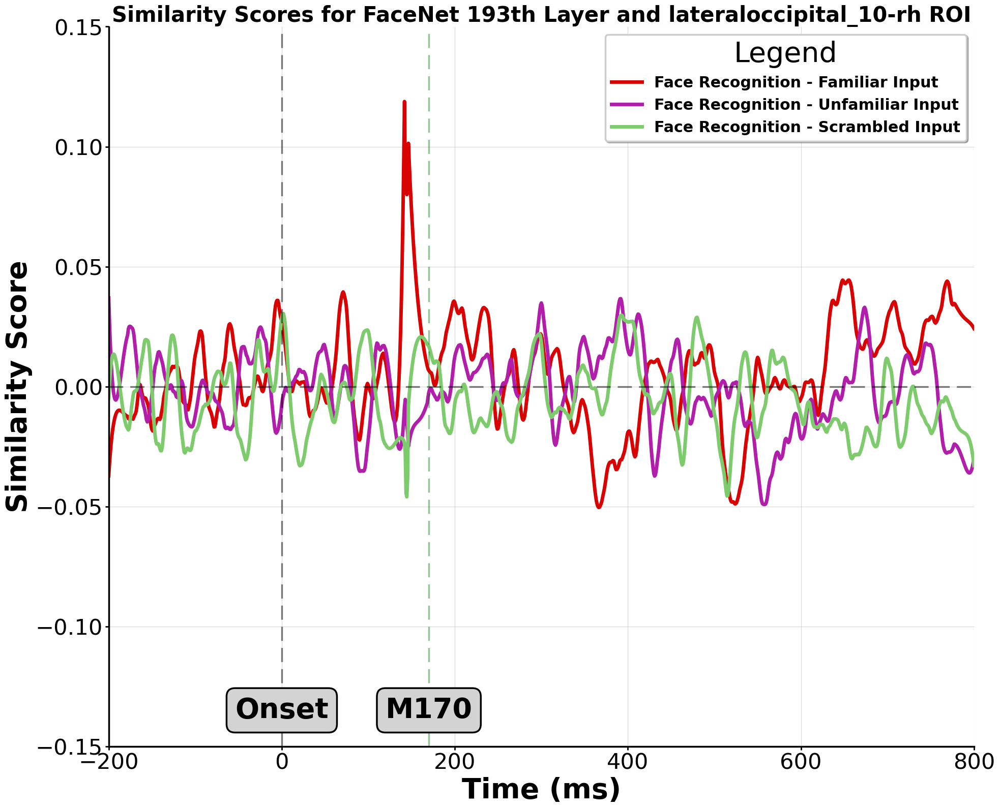

In [21]:
fig
smoothing = "not_smoothed"
# Create a PDF file to save the plots
activation_types = [ "imagenet",  "imagenet", "trained",]
ann_analysis_types = [ "meg_stimuli_faces", "None", "with-meg_pretrained", ]
labels = ["Dual Task - Familiar Input", "Object Recognition - Familiar Input", "Face Recognition - Familiar Input",]
stimuli_type = "fam"
k = 193
i = 3

colors = [ pink_ocean[4], pink_ocean[7], one_piece[2], one_piece[3]]
roi = region_name[i]
fig, axs = plt.subplots(figsize=(20, 16), nrows=1, ncols=1)

for stimuli_type, color, label in zip(["fam", "unfamiliar", "scrambled"], [one_piece[2], pink_ocean[-2], green_bull[4]], ["Face Recognition - Familiar Input", "Face Recognition - Unfamiliar Input", "Face Recognition - Scrambled Input"]):
    folder = os.path.join(similarity_folder, f"{model}_with-meg_pretrained_trained_{stimuli_type}")
    file_path = os.path.join(folder, f"raw_{model}_with-meg_pretrained_{roi}_rdm_trained_{stimuli_type}.npy")
    file = np.load(file_path)
    # Get the values from file[0,:,k,0]
    values = file[0,:,k,0]
    window_size = 30 if label == "Face Recognition" else 50

    # Create a mask for values between 170 and 200
    values = file[0,:,k,0]

    # Create an array to store the smoothed values
    smoothed_values = np.zeros_like(values)

    # Smooth values with indices between 170 and 200
    smoothed_values[377:381] = scipy.signal.savgol_filter(values[377:381], 4, 3)

    # Assign a value of 50 to the rest of the values
    smoothed_values[:377] = scipy.signal.savgol_filter(values[:377], 50, 4)
    smoothed_values[381:] = scipy.signal.savgol_filter(values[381:], 50, 4)
    axs.plot(time_values, smoothed_values, label=label, color=color, linewidth=5)

    # for ax in axs.flatten():
    #     ax.set_title("Left Hemisphere" if ax == axs[0] else "Right Hemisphere", fontsize=50)
axs.set_xlabel("Time (ms)", fontsize=40, fontweight='bold')
axs.set_ylabel("Similarity Score", fontsize=40, fontweight='bold')
axs.set_xlim(-200, 800)
axs.set_ylim(-0.15, 0.15)
axs.grid(True, alpha=0.5)
axs.axvline(x=0, color='k', linestyle='--', alpha=0.5)
axs.axhline(y=0, color='k',  alpha=0.5, linestyle="--")
axs.axvline(x=170, color=one_piece[-3], alpha=0.4, linestyle="--")

bbox_props = dict(boxstyle="round, pad=0.3", edgecolor="black", facecolor="lightgrey")
axs.text(.2, 0.05, "Onset", fontsize=40, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)
axs.text(.370, 0.05, "M170", fontsize=40, fontweight='bold', ha="center", va="center", transform=axs.transAxes, bbox=bbox_props)

axs.legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
fig.tight_layout()
axs.set_title(f"Similarity Scores for {model} {k}th Layer and {roi} ROI", fontsize=30, fontweight='bold')

# Save the plot in a  png file
plt.savefig(f"{plots_folder}/final/Inputs_{model}_{stimuli_type}_rdm_plots_{main_region}.png")

In [23]:
main_region = "inferiortemporal"
fusiform_labels = [i for i, label in enumerate(rois) if main_region in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]
model_layes = 404
model = "FaceNet"

with-meg_pretrained trained
meg_stimuli_faces imagenet
None imagenet
None untrained


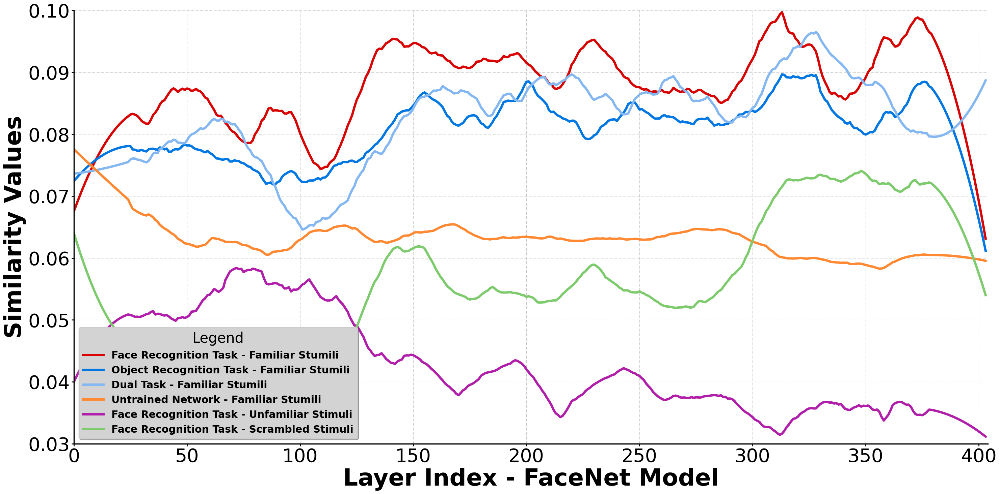

In [44]:
labels = [ "Face Recognition Task - Familiar Stumili", "Object Recognition Task - Familiar Stumili", "Dual Task - Familiar Stumili", "Untrained Network - Familiar Stumili",]
fig, axs = plt.subplots(figsize=(30, 15))
activations = [ "trained", "imagenet",  "imagenet", "untrained",]
ann_analysis_types = ["with-meg_pretrained", "meg_stimuli_faces", "None", "None" ]

time_segment = "550"
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]
for ann_analysis_type, activation_type, color, label in zip(ann_analysis_types, activations, colors, labels):
    print(ann_analysis_type, activation_type)
    data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_fam_{time_segment}_50.npy")
    data = np.load(data_file)
    data[data[:, :, :, 1] > 0.05] = 0
    max_values = np.max(data[:, 2, :, 0], axis=0)
    window_size = 50
    smoothed_values = scipy.signal.savgol_filter(max_values, window_size, 2)
    axs.plot(np.arange(0, len(max_values)), smoothed_values, label=label, color=color, linewidth=5)


data_file = os.path.join(similarity_folder, f"avg_FaceNet_with-meg_pretrained_meg_rdm_trained_unfamiliar_{time_segment}_50.npy")
data = np.load(data_file)
data[data[:, :, :, 1] > 0.05] = 0
max_values = np.max(data[:, 2, :, 0], axis=0)
window_size = 50
smoothed_values = scipy.signal.savgol_filter(max_values, window_size, 2)
axs.plot(np.arange(0, len(max_values)), smoothed_values, label="Face Recognition Task - Unfamiliar Stimuli", color=pink_ocean[-2], linewidth=5)

data_file = os.path.join(similarity_folder, f"avg_FaceNet_with-meg_pretrained_meg_rdm_trained_scrambled_{time_segment}_50.npy")
data = np.load(data_file)
data[data[:, :, :, 1] > 0.05] = 0
max_values = np.max(data[:, 2, :, 0], axis=0)
window_size = 50
smoothed_values = scipy.signal.savgol_filter(max_values, window_size, 2)
axs.plot(np.arange(0, len(max_values)), smoothed_values, label="Face Recognition Task - Scrambled Stimuli", color=green_bull[4], linewidth=5)


axs.set_ylim(0.03, 0.10)
axs.set_xlim(0, 404)
# plt.suptitle(f"Comparison of including of face stimuli to train FaceNet - Familiar Stimuli", x=0.45, y=1)
axs.legend(loc='lower left', title="Legend", fontsize=30, title_fontsize=30, shadow=True, fancybox=True, prop={'weight':'bold'}, facecolor='lightgrey')
axs.set_xlabel("Layer Index - FaceNet Model", fontsize=50, fontweight='bold')
axs.set_ylabel("Similarity Values", fontsize=50, fontweight='bold')
axs.grid(True, linestyle='--', alpha=0.7)
axs.tick_params(axis='both', which='major', labelsize=40)

plt.tight_layout()
# Save the plot
plt.savefig(os.path.join(plots_folder, "final" ,f'influence_of_including_meg_stimuli_FaceNet.png'), dpi=300)
plt.show()


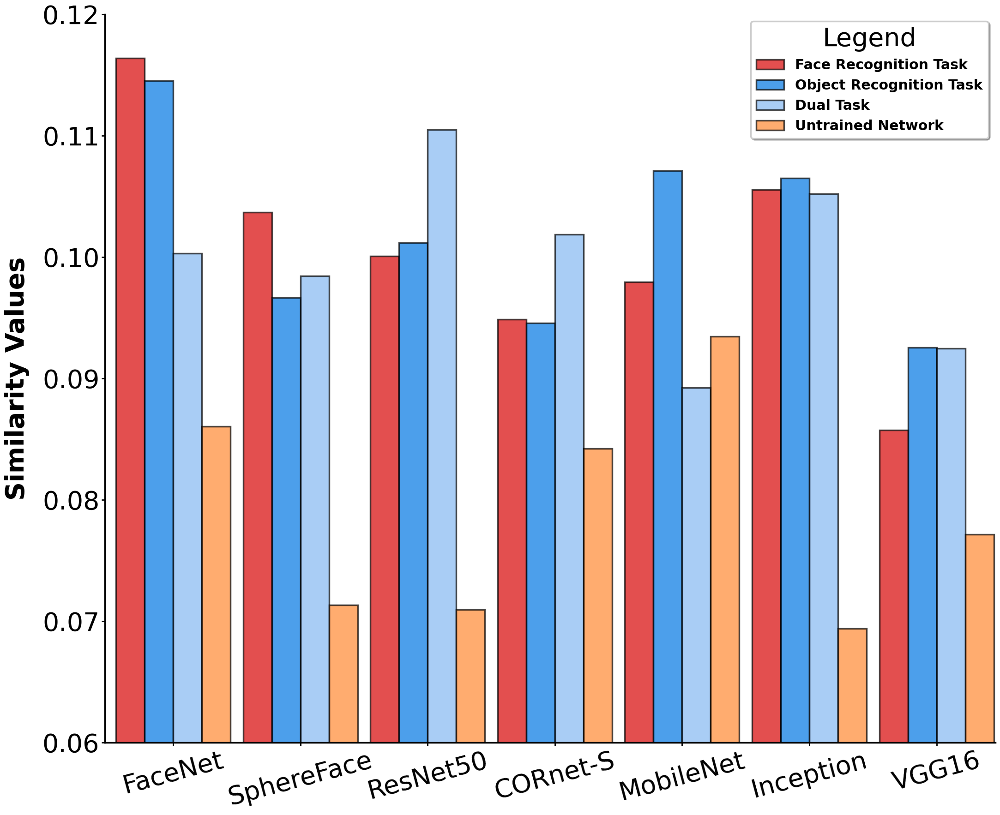

In [53]:
models = ["FaceNet", "SphereFace","resnet50", "cornet_s",    "mobilenet", "inception_v3", "vgg16_bn", ]
model_names = ["FaceNet", "SphereFace", "ResNet50", "CORnet-S",     "MobileNet", "Inception", "VGG16", ]
labels = [ "Face Recognition Task", "Object Recognition Task", "Dual Task", "Untrained Network",]

time_segment = 550
sampling_diff = 50
ann_analysis_types = [ "with-meg_pretrained", "None", "meg_stimuli_faces", "None",]
activations = [ "trained", "imagenet",  "imagenet", "untrained",]
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]

fig, ax = plt.subplots(figsize=(22, 18))
time_segment_sim_values = [[] for _ in range(7)]
for model_idx, model in enumerate(models):
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_fam_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_value = np.max(data[:, 2, :, 0])
        time_segment_sim_values[model_idx].append(max_value)
bar_width = 0.9/len(time_segment_sim_values[0]) # Width of each bar

for n_experiments in range(len(time_segment_sim_values[0])):
    list_values = [model_sim_values[n_experiments] for model_sim_values in time_segment_sim_values]
    ax.bar(np.arange(len(models))+bar_width*n_experiments, list_values, width=bar_width, alpha=0.7, edgecolor='black', color=colors[n_experiments], label=labels[n_experiments])
x_ticks = [ bar_width*(len(time_segment_sim_values[0])//2 - 0.5) + idx_model for idx_model in np.arange(len(models)) ]
ax.set_xticks(x_ticks)
ax.set_xticklabels(model_names, rotation=15)
ax.set_ylabel("Similarity Values", fontsize=40, labelpad=20, fontweight='bold')
ax.set_ylim(0.06, 0.12)
ax.set_xlim(-0.2, 6.8)
ax.legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})

ax.tick_params(axis='both', which='major', labelsize=40,)
# ax.set_xlabel("Model", fontsize=40, labelpad=20, fontweight='bold')
# # Set main title
# plt.suptitle(f"Max Similarity values for different experiments", x=0.5, y=1, fontsize=60)

# # Adjust layout
plt.tight_layout()  

# # Save the plot
plt.savefig(os.path.join(plots_folder, "final", f'Max_similarity_values_different_experiments.png'), dpi=300, bbox_inches='tight')
plt.show()

# What about the regions

In [30]:
import mne
from matplotlib import colormaps
from mne.viz import Brain
cmap= colormaps["bwr"]
rois = mne.read_labels_from_annot(parc='aparc_sub', subject='fsaverage', subjects_dir=subjects_dir)


Reading labels from parcellation...
   read 226 labels from /Users/hamzaabdelhedi/Projects/data/MFRS_data/subjects/fsaverage/label/lh.aparc_sub.annot
   read 224 labels from /Users/hamzaabdelhedi/Projects/data/MFRS_data/subjects/fsaverage/label/rh.aparc_sub.annot


In [31]:
# data_file = os.path.join(path, "avg_cornet_s_without-meg_pretrained_rdm_trained.npy")

# data = np.load(data_file)
model ="FaceNet"
activation_type = "trained"
ann_analysis_type = "with-meg_pretrained"
stimuli_type = "fam"
folder = os.path.join(similarity_folder, f"{model}_{ann_analysis_type}_{activation_type}_{stimuli_type}")
brain_data = np.zeros((450, 1101))
for i, roi in enumerate(rois):
    if roi.name == "unknown-lh" or roi.name == "unknown-rh":
        continue
    try:
        data_file = os.path.join(folder, f"raw_{model}_{ann_analysis_type}_{roi.name}_rdm_{activation_type}_{stimuli_type}.npy")
        data = np.load(data_file)
        data = data[0, :, 352, 0]
        brain_data[i] = data
    except Exception as e:
        print(f"An error occurred: {e}")
        print(f"An error occurred for {roi.name}")


An error occurred: cannot reshape array of size 888832 into shape (1,1101,404,2)
An error occurred for inferiortemporal_7-rh
An error occurred: cannot reshape array of size 888832 into shape (1,1101,404,2)
An error occurred for pericalcarine_3-lh
An error occurred: cannot reshape array of size 0 into shape (1,1101,404,2)
An error occurred for superiorparietal_8-rh


In [32]:
test = mne.labels_to_stc(rois, brain_data, tmin = -0.2, tstep = 0.0009090909090909091, subject='fsaverage')

In [33]:
brain_data.max()

0.1343032847138154

In [34]:
cmap_2 = continuous_color_map("pink_ocean", vmin=-.135, vmax=.135)

Using notebook 3d backend.



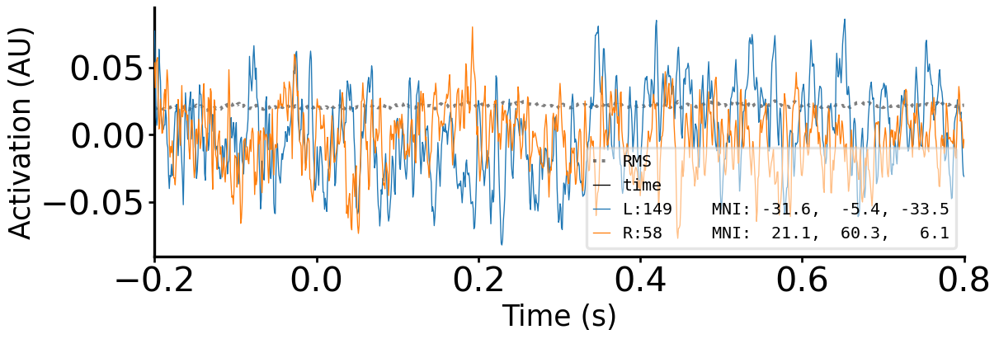

[webm @ 0x121604940] Only VP8 or VP9 or AV1 video and Vorbis or Opus audio and WebVTT subtitles are supported for WebM.
[out#0/webm @ 0x121604880] Could not write header (incorrect codec parameters ?): Invalid argument
Error while filtering: Invalid argument
[out#0/webm @ 0x121604880] Nothing was written into output file, because at least one of its streams received no packets.
/Users/hamzaabdelhedi/Projects/Master_project/venv11/lib/python3.11/site-packages/ipywidgets/widgets/widget.py:207: RuntimeWarning: Movie saving aborted:
Traceback (most recent call last):
  File "/Users/hamzaabdelhedi/Projects/Master_project/venv11/lib/python3.11/site-packages/imageio_ffmpeg/_io.py", line 627, in write_frames
    p.stdin.write(bb)
BrokenPipeError: [Errno 32] Broken pipe

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/hamzaabdelhedi/Projects/Master_project/venv11/lib/python3.11/site-packages/mne/viz/_brain/_brain.py", line 3

 JS Error => Missing header for received binary message
 JS Error => Missing header for received binary message


In [ ]:
test.plot(hemi='both', transparent=True, title="FaceNet 352th Layer - Face Recognition - Familiar Stimuli - Caudal View",
          subjects_dir=subjects_dir, smoothing_steps=100, time_viewer=True, size=(1200, 1200), background='white', backend='auto',
           initial_time=-0.2, time_unit='s', colormap='bwr', clim=dict(kind='value', lims=[-0.135, 0., 0.135]))

In [36]:
import cv2
from moviepy.editor import VideoFileClip, concatenate_videoclips


In [44]:
import cv2

def change_fps(input_video, output_video, target_fps):
    # Open the input video file
    cap = cv2.VideoCapture(input_video)

    # Get the current frames per second (fps) of the video
    current_fps = cap.get(cv2.CAP_PROP_FPS)

    # Get the frame width and height
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create an output video writer
    out = cv2.VideoWriter(output_video, cv2.VideoWriter_fourcc(*'mp4v'), target_fps, (frame_width, frame_height))

    # Iterate through the frames and write to the output video
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        out.write(frame)

    # Release the video capture and writer objects
    cap.release()
    out.release()

    print(f"Video with new FPS ({target_fps}) saved to {output_video}")

# Example usage
input_video = 'medial.mp4'
output_video = 'output_medial.mp4'
target_fps = 40

change_fps(input_video, output_video, target_fps)


Video with new FPS (40) saved to output_medial.mp4


In [40]:
import cv2

def change_fps(input_video, output_video, target_fps, slow_start_time, slow_end_time, slow_target_fps):
    # Open the input video file
    cap = cv2.VideoCapture(input_video)

    # Get the current frames per second (fps) of the video
    current_fps = cap.get(cv2.CAP_PROP_FPS)

    # Get the frame width and height
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create an output video writer
    out = cv2.VideoWriter(output_video, cv2.VideoWriter_fourcc(*'mp4v'), target_fps, (frame_width, frame_height))

    # Calculate frame count and frame number at start and end of slow segment
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    slow_start_frame = int(slow_start_time * current_fps)
    slow_end_frame = min(int(slow_end_time * current_fps), total_frames - 1)

    # Iterate through the frames and write to the output video
    frame_number = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Check if current frame is within the slow segment
        if slow_start_frame <= frame_number <= slow_end_frame:
            out.write(frame)  # Write frame at original FPS
            for _ in range(int(current_fps / slow_target_fps) - 1):
                out.write(frame)  # Write additional frames to slow down
        else:
            out.write(frame)  # Write frame at original FPS

        frame_number += 1

    # Release the video capture and writer objects
    cap.release()
    out.release()

    print(f"Video with new FPS ({target_fps}) and slowed segment ({slow_target_fps}) saved to {output_video}")

# Example usage
input_video = 'medial.mp4'
output_video = 'output_medial.ogv'
target_fps = 50

# Slow down a segment from 5 to 10 seconds with a target FPS of 20
slow_start_time = 35
slow_end_time = 45
slow_target_fps = 5

change_fps(input_video, output_video, target_fps, slow_start_time, slow_end_time, slow_target_fps)


OpenCV: FFMPEG: tag 0x7634706d/'mp4v' is not supported with codec id 12 and format 'ogv / Ogg Video'
[ogv @ 0x3cc6b10b0] Unsupported codec id in stream 0
[ERROR:0@349.877] global cap.cpp:645 open VIDEOIO(CV_IMAGES): raised OpenCV exception:

OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/videoio/src/cap_images.cpp:430: error: (-215:Assertion failed) !filename_pattern.empty() in function 'open'




Video with new FPS (50) and slowed segment (5) saved to output_medial.ogv


: 

In [ ]:

def adjust_speed(video_file, output_file):
    # Load the video using MoviePy
    video = VideoFileClip(video_file)

    # Calculate the durations for each segment (20% at the beginning, 60% in the middle, 20% at the end)
    total_duration = video.duration
    first_duration = total_duration * 0.2
    middle_duration = total_duration * 0.6
    last_duration = total_duration * 0.2

    # Calculate the target speeds for each segment
    first_speed = 2.0  # Double speed
    middle_speed = 0.5  # Half speed
    last_speed = 2.0  # Double speed

    # Split the video into three segments
    first_clip = video.subclip(0, first_duration)
    middle_clip = video.subclip(first_duration, first_duration + middle_duration)
    last_clip = video.subclip(first_duration + middle_duration, total_duration)

    # Apply speed adjustments to each segment
    first_clip = first_clip.fx(VideoFileClip.speedx, first_speed)
    middle_clip = middle_clip.fx(VideoFileClip.speedx, middle_speed)
    last_clip = last_clip.fx(VideoFileClip.speedx, last_speed)

    # Concatenate the segments
    final_clip = concatenate_videoclips([first_clip, middle_clip, last_clip])

    # Write the final video to a file
    final_clip.write_videofile(output_file, codec='libx264', fps=30)

    # Close the clips
    video.close()
    final_clip.close()

# Example usage
input_video = 'input_video.mp4'
output_video = 'output_video.mp4'

adjust_speed(input_video, output_video)


In [350]:
list_views[f"{ann_analysis_type} {activation_type} {stimuli_type} caudal"] = cropped_screenshot

In [351]:
brain.add_annotation(
[(labels_lh, ctab_lh), (labels_rh, ctab_rh)], borders=False, alpha=1.0, remove_existing=True
)
brain.show_view("ventral") #caudal, ventral 
# Get screenshot and crop it
screenshot = brain.screenshot()
nonwhite_pix = (screenshot != 255).any(-1)
nonwhite_row = nonwhite_pix.any(1)
nonwhite_col = nonwhite_pix.any(0)
cropped_screenshot = screenshot[nonwhite_row][:, nonwhite_col]

In [182]:
import pickle

# Save the list to a file
with open('list_views_16_12_23.pkl', 'wb') as f:
    pickle.dump(list_views, f)


/var/folders/dy/yqsbvh6j7r7gz1ktnr8gx4g80000gn/T/ipykernel_72841/2359224396.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


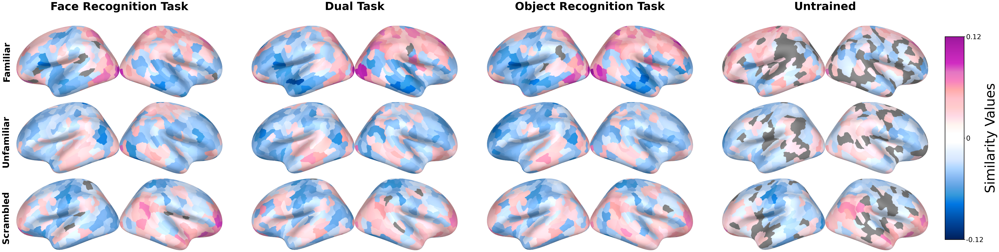

In [310]:
from matplotlib.colors import Normalize

fig, axs = plt.subplots(3, 4, figsize=(60, 16))
for i , stimuli_type in enumerate(["fam", "unfamiliar", "scrambled"]):
    for j, ann_analysis_type in enumerate(["with-meg_pretrained trained", "meg_stimuli_faces imagenet", "None imagenet",  "None untrained"]):
        axs[i, j].imshow(list_views[ann_analysis_type + " " + stimuli_type + " lateral"])
        axs[i, j].axis('off')


# # Add labels for each subplot
axs[0, 0].set_title('Face Recognition Task', fontsize=50, fontweight='bold', y=1.2)
axs[0, 1].set_title('Dual Task', fontsize=50, fontweight='bold', y=1.2)
axs[0, 2].set_title('Object Recognition Task', fontsize=50, fontweight='bold', y=1.2)
axs[0, 3].set_title('Untrained', fontsize=50, fontweight='bold', y=1.2)

ax2 = fig.add_axes([0.017, 0.665, 0.02, 0.2])
ax2.axis('off')
ax2.set_title('Familiar', fontsize=40, fontweight='bold', rotation='vertical', y=0.1, x = -0.05)
axs[1, 0].set_title('Unfamiliar', fontsize=40, fontweight='bold', rotation='vertical', y=0.1, x = -0.05)
axs[2, 0].set_title('Scrambled', fontsize=40, fontweight='bold', rotation='vertical', y=0.1, x = -0.05)


cbar_ax = fig.add_axes([1, 0.06, 0.02, 0.8])
norm = Normalize(vmin=-max_val, vmax=max_val)
cbar = plt.colorbar(cmap_2, cax=cbar_ax, ticks=[-0.1164, 0, 0.1164])
cbar.set_ticklabels(['-0.12', '0', '0.12'])
cbar.set_label('Similarity Values', fontsize=60) 

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(os.path.join(plots_folder, f'FaceNet_brain_maps_lateral.png'), dpi=300)
plt.show()



/var/folders/dy/yqsbvh6j7r7gz1ktnr8gx4g80000gn/T/ipykernel_72841/2215677381.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


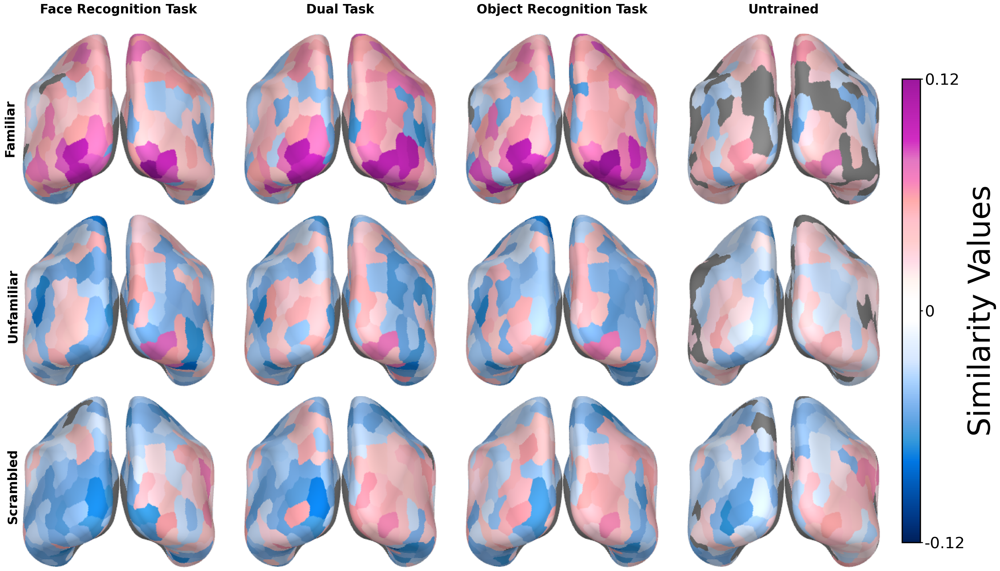

In [358]:
from matplotlib.colors import Normalize

fig, axs = plt.subplots(3, 4, figsize=(25, 16))
for i , stimuli_type in enumerate(["fam", "unfamiliar", "scrambled"]):
    for j, ann_analysis_type in enumerate(["with-meg_pretrained trained", "meg_stimuli_faces imagenet", "None imagenet",  "None untrained"]):
        axs[i, j].imshow(list_views[ann_analysis_type + " " + stimuli_type + " caudal"])
        axs[i, j].axis('off')


# # Add labels for each subplot
axs[0, 0].set_title('Face Recognition Task', fontsize=25, fontweight='bold', y=1.1)
axs[0, 1].set_title('Dual Task', fontsize=25, fontweight='bold', y=1.1)
axs[0, 2].set_title('Object Recognition Task', fontsize=25, fontweight='bold', y=1.1)
axs[0, 3].set_title('Untrained', fontsize=25, fontweight='bold', y=1.1)

ax2 = fig.add_axes([0.017, 0.665, 0.02, 0.2])
ax2.axis('off')
ax2.set_title('Familiar', fontsize=25, fontweight='bold', rotation='vertical', y=0.3, x = -0.05)
axs[1, 0].set_title('Unfamiliar', fontsize=25, fontweight='bold', rotation='vertical', y=0.25, x = -0.05)
axs[2, 0].set_title('Scrambled', fontsize=25, fontweight='bold', rotation='vertical', y=0.25, x = -0.05)


cbar_ax = fig.add_axes([1, 0.06, 0.02, 0.8])
norm = Normalize(vmin=-max_val, vmax=max_val)
cbar = plt.colorbar(cmap_2, cax=cbar_ax, ticks=[-0.1164, 0, 0.1164])
cbar.set_ticklabels(['-0.12', '0', '0.12'])
cbar.set_label('Similarity Values', fontsize=60) 

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(os.path.join(plots_folder, f'FaceNet_brain_maps_caudal.png'), dpi=300)
plt.show()



/var/folders/dy/yqsbvh6j7r7gz1ktnr8gx4g80000gn/T/ipykernel_72841/2002116778.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


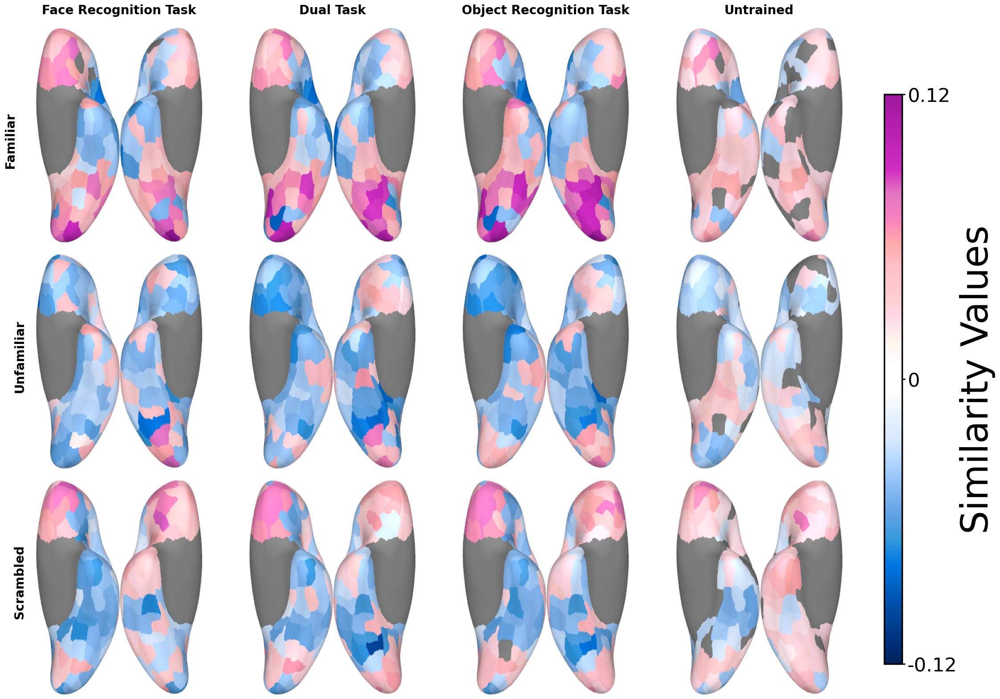

In [368]:
from matplotlib.colors import Normalize

fig, axs = plt.subplots(3, 4, figsize=(20, 16))
for i , stimuli_type in enumerate(["fam", "unfamiliar", "scrambled"]):
    for j, ann_analysis_type in enumerate(["with-meg_pretrained trained", "meg_stimuli_faces imagenet", "None imagenet",  "None untrained"]):
        axs[i, j].imshow(list_views[ann_analysis_type + " " + stimuli_type + " ventral"])
        axs[i, j].axis('off')


# # Add labels for each subplot
axs[0, 0].set_title('Face Recognition Task', fontsize=20, fontweight='bold', y=1.05)
axs[0, 1].set_title('Dual Task', fontsize=20, fontweight='bold', y=1.05)
axs[0, 2].set_title('Object Recognition Task', fontsize=20, fontweight='bold', y=1.05)
axs[0, 3].set_title('Untrained', fontsize=20, fontweight='bold', y=1.05)

ax2 = fig.add_axes([0.017, 0.665, 0.02, 0.2])
ax2.axis('off')
ax2.set_title('Familiar', fontsize=20, fontweight='bold', rotation='vertical', y=0.45, x = 0.1)
axs[1, 0].set_title('Unfamiliar', fontsize=20, fontweight='bold', rotation='vertical', y=0.35, x = -0.1)
axs[2, 0].set_title('Scrambled', fontsize=20, fontweight='bold', rotation='vertical', y=0.35, x = -0.1)


cbar_ax = fig.add_axes([1, 0.06, 0.02, 0.8])
norm = Normalize(vmin=-max_val, vmax=max_val)
cbar = plt.colorbar(cmap_2, cax=cbar_ax, ticks=[-0.1164, 0, 0.1164])
cbar.set_ticklabels(['-0.12', '0', '0.12'])
cbar.set_label('Similarity Values', fontsize=60) 

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(os.path.join(plots_folder, f'FaceNet_brain_maps_ventral.png'), dpi=300)
plt.show()



In [19]:
# Extract fusiform region data
fusiform_labels = [i for i, label in enumerate(rois) if "fusiform" in label.name.split('_')[0]]
region_name = [rois[i].name for i in fusiform_labels]


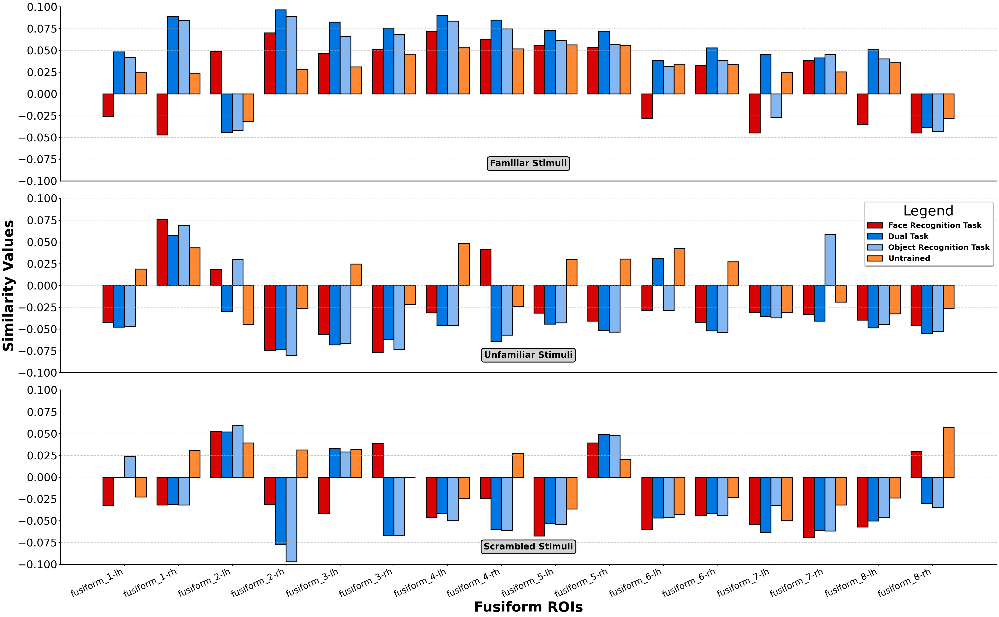

In [21]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(40, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[fusiform_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.10, 0.10)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=40, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
    axs[stimuli_idx].set_xticks(np.arange(len(fusiform_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('Fusiform ROIs', fontsize=40, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in fusiform_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        pass
        # axs[stimuli_idx].set_title(f'Similarity Values for Fusiform ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, "final",f'FaceNet_fusiform_similarity_values.png'), dpi=300)
plt.show()

In [17]:
# Extract occipital region data
occipital_labels = [i for i, label in enumerate(rois) if "occipital" in label.name.split('_')[0]]
region_name = [rois[i].name for i in occipital_labels]

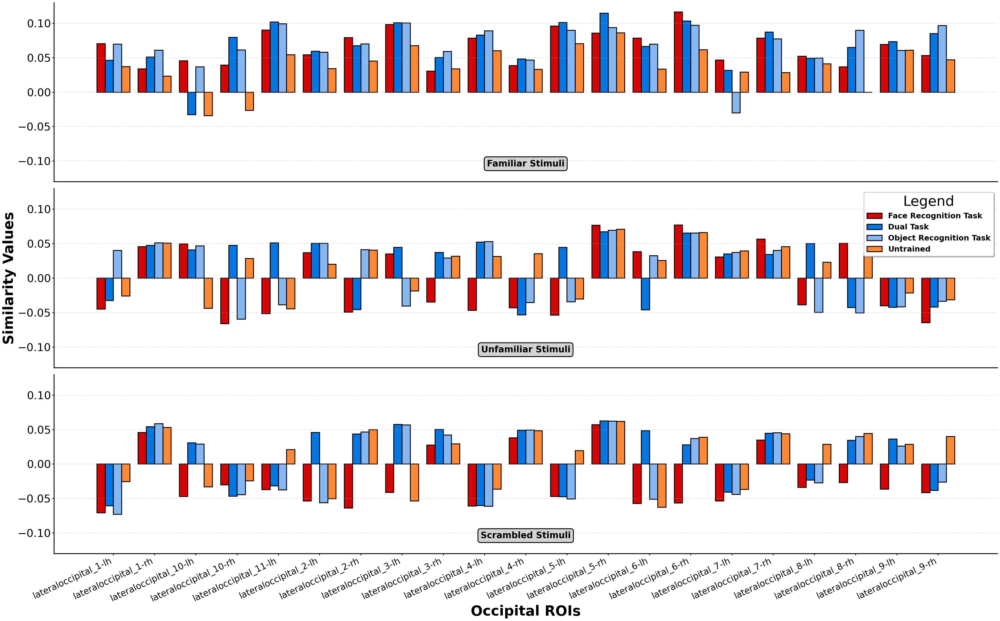

In [18]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(40, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[occipital_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.13, 0.13)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=40, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
    axs[stimuli_idx].set_xticks(np.arange(len(occipital_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('Occipital ROIs', fontsize=40, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in occipital_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        pass
        # axs[stimuli_idx].set_title(f'Similarity Values for Occipital ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, "final", f'FaceNet_occipital_similarity_values.png'), dpi=300)
plt.show()

In [12]:
# Extract IT region data
inferiortemporal_labels = [i for i, label in enumerate(rois) if "inferiortemporal" in label.name.split('_')[0]]
region_name = [rois[i].name for i in inferiortemporal_labels]

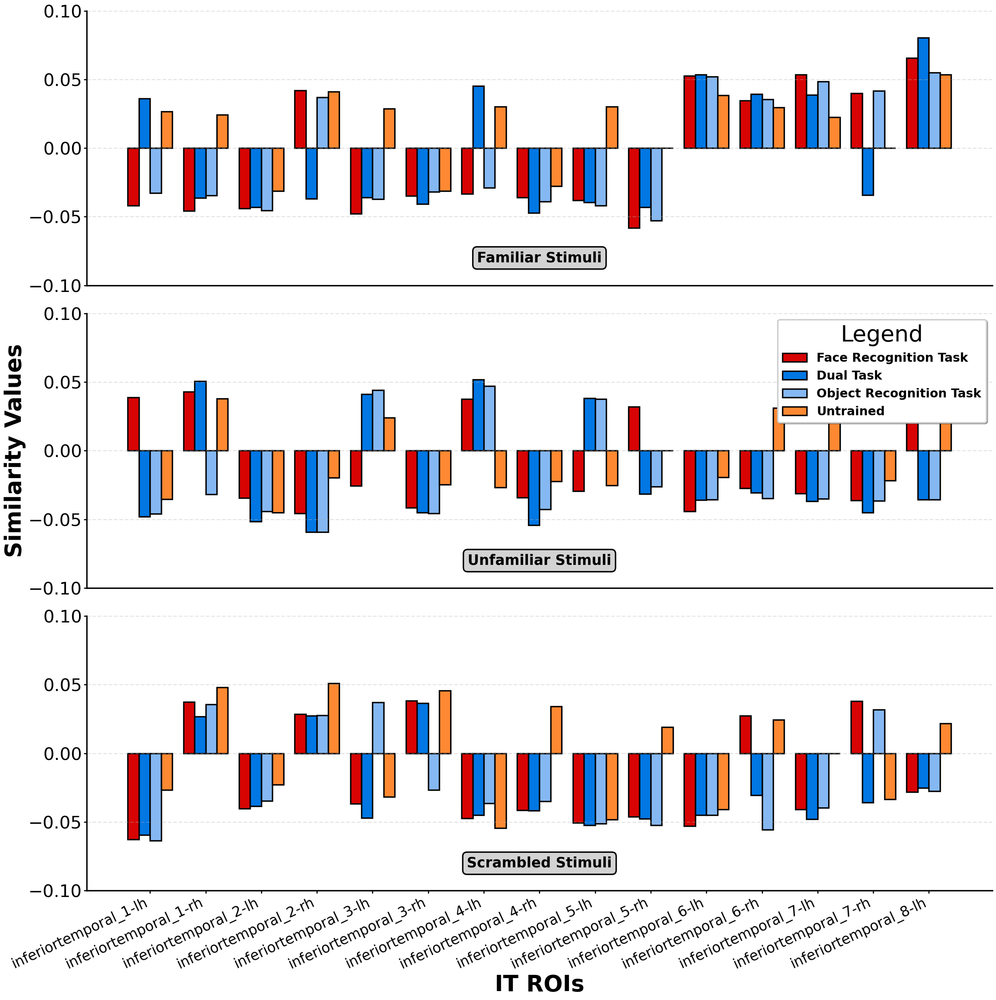

In [13]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(25, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[inferiortemporal_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.10, 0.10)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=40, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
    axs[stimuli_idx].set_xticks(np.arange(len(inferiortemporal_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('IT ROIs', fontsize=40, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in inferiortemporal_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        pass
        # axs[stimuli_idx].set_title(f'Similarity Values for IT ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, "final", f'FaceNet_IT_similarity_values.png'), dpi=300)
plt.show()

In [562]:
# Extract IT region data
inferiorparietal_labels = [i for i, label in enumerate(rois) if "inferiorparietal" in label.name.split('_')[0]]
region_name = [rois[i].name for i in inferiorparietal_labels]

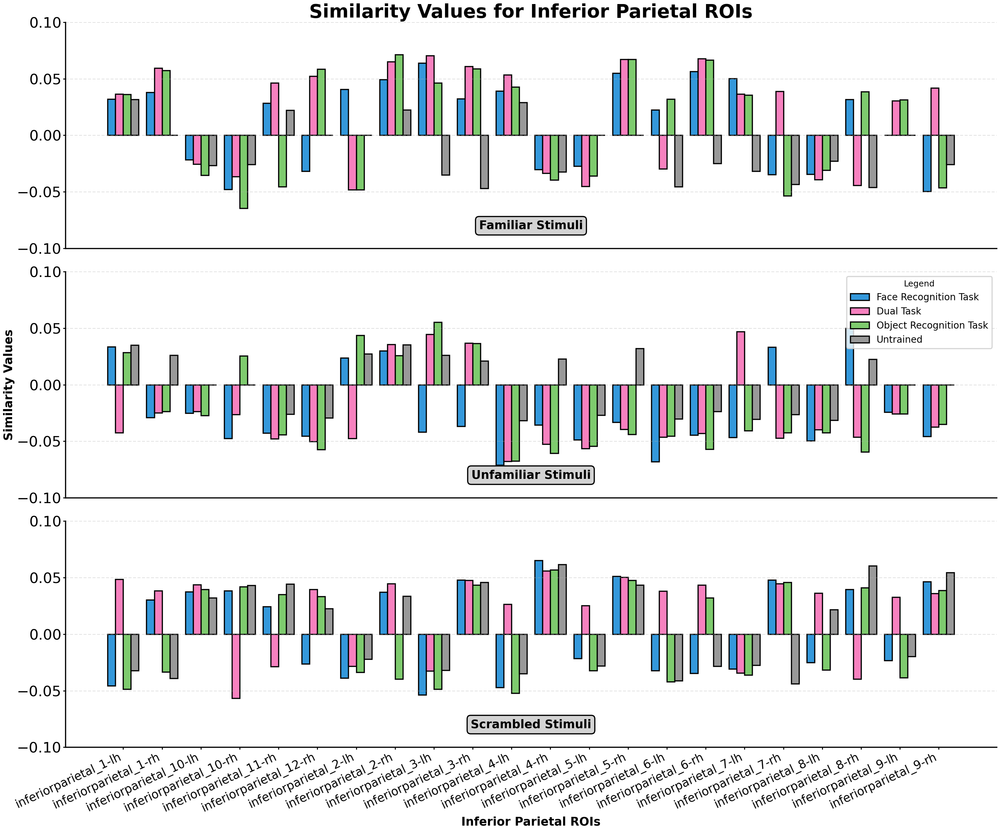

In [563]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [the_blues[5], oppenheimer[5], green_bull[4], grey[2]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(30, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[inferiorparietal_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.10, 0.10)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=25, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=20)
    axs[stimuli_idx].set_xticks(np.arange(len(inferiorparietal_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('Inferior Parietal ROIs', fontsize=25, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in inferiorparietal_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        axs[stimuli_idx].set_title(f'Similarity Values for Inferior Parietal ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, f'FaceNet_Inferior_Parietal_similarity_values.png'), dpi=300)
plt.show()

In [565]:
# Extract IT region data
unique_labels = []
for i, label in enumerate(rois):
    unique_labels.append(label.name.split('_')[0])
print(np.unique(unique_labels))

['bankssts' 'caudalanteriorcingulate' 'caudalmiddlefrontal' 'cuneus'
 'entorhinal' 'frontalpole' 'fusiform' 'inferiorparietal'
 'inferiortemporal' 'insula' 'isthmuscingulate' 'lateraloccipital'
 'lateralorbitofrontal' 'lingual' 'medialorbitofrontal' 'middletemporal'
 'paracentral' 'parahippocampal' 'parsopercularis' 'parsorbitalis'
 'parstriangularis' 'pericalcarine' 'postcentral' 'posteriorcingulate'
 'precentral' 'precuneus' 'rostralanteriorcingulate'
 'rostralmiddlefrontal' 'superiorfrontal' 'superiorparietal'
 'superiortemporal' 'supramarginal' 'temporalpole' 'transversetemporal'
 'unknown-lh' 'unknown-rh']


In [14]:
# Extract IT region data
bankssts_labels = [i for i, label in enumerate(rois) if "bankssts" in label.name.split('_')[0]]
region_name = [rois[i].name for i in bankssts_labels]

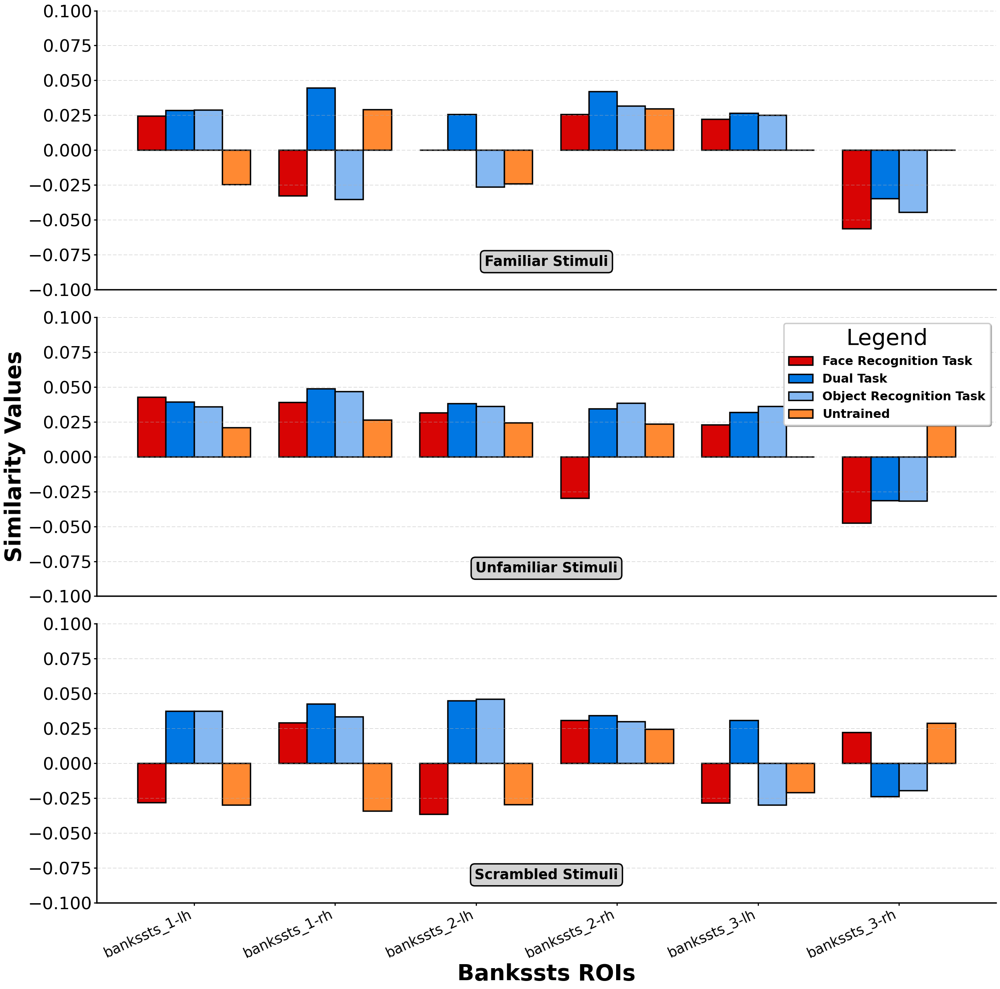

In [15]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [one_piece[2],  pink_ocean[4], pink_ocean[7], one_piece[3],pink_ocean[-2], pink_ocean[-5], pink_ocean[-8]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(25, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[bankssts_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.10, 0.10)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=40, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=40, title_fontsize=40, shadow=True, fancybox=True, prop={'weight':'bold'})
    axs[stimuli_idx].set_xticks(np.arange(len(bankssts_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('Bankssts ROIs', fontsize=40, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in bankssts_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        pass
        # axs[stimuli_idx].set_title(f'Similarity Values for Bankssts ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, "final",f'FaceNet_Inferior_bankssts_similarity_values.png'), dpi=300)
plt.show()

In [568]:
# Extract IT region data
middletemporal_labels = [i for i, label in enumerate(rois) if "middletemporal" in label.name.split('_')[0]]
region_name = [rois[i].name for i in middletemporal_labels]

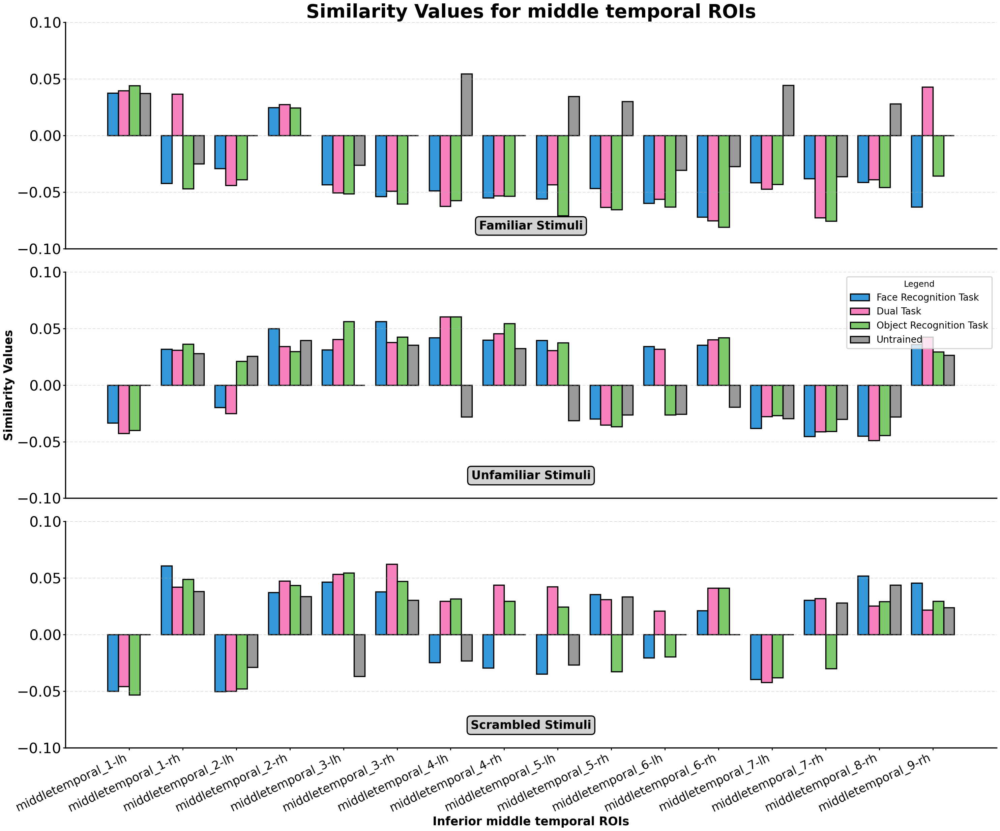

In [570]:
model = "FaceNet"
labels = [ "Face Recognition Task", "Dual Task", "Object Recognition Task",  "Untrained",]
ann_analysis_types = ["with-meg_pretrained",  "None", "meg_stimuli_faces", "None", ]
activations = ["trained", "imagenet", "imagenet", "untrained",]
stimuli_types = ["fam", "unfamiliar", "scrambled"]

time_segment = 550
sampling_diff = 50
colors = [the_blues[5], oppenheimer[5], green_bull[4], grey[2]]
# colors = [one_piece[0], one_piece[2], one_piece[12], one_piece[-1]]
fig, ax = plt.subplots(3, 1, figsize=(30, 25))
axs = ax.flatten()
for stimuli_idx, stimuli_type in enumerate(stimuli_types):
    sim_values = []
    for ann_analysis_type, activation_type in zip(ann_analysis_types, activations):
        data_file = os.path.join(similarity_folder, f"avg_{model}_{ann_analysis_type}_meg_rdm_{activation_type}_{stimuli_type}_{time_segment}_50.npy")
        data = np.load(data_file)
        data[data[:, :, :, 1] > 0.05] = 0
        max_values = np.max(data[:, 2, :, 0], axis=1)
        min_values = np.min(data[:, 2, :, 0], axis=1)
        extreme_values = np.where(np.abs(min_values) > max_values, min_values, max_values)
        values = extreme_values
        sim_values.append(values[middletemporal_labels])
    bar_width = 0.8/len(sim_values)
    for idx_analysis in range(len(ann_analysis_types)):
        analysis_sim_values = sim_values[idx_analysis]
        axs[stimuli_idx].bar(np.arange(len(analysis_sim_values))+bar_width*idx_analysis, analysis_sim_values, width=bar_width, edgecolor='black', color=colors[idx_analysis], label=labels[idx_analysis])
    axs[stimuli_idx].set_ylim(-0.10, 0.10)
    if stimuli_idx == 1:
        axs[stimuli_idx].set_ylabel("Similarity Values", fontsize=25, fontweight='bold')
        axs[stimuli_idx].legend(loc='upper right', title="Legend", fontsize=20)
    axs[stimuli_idx].set_xticks(np.arange(len(middletemporal_labels)) + 1.5 * bar_width)  # Adjust the X ticks to be in the middle of grouped bars
    if stimuli_idx == 2:
        axs[stimuli_idx].set_xlabel('Inferior middle temporal ROIs', fontsize=25, fontweight='bold')
        axs[stimuli_idx].set_xticklabels([rois[i].name for i in middletemporal_labels], fontsize=25, rotation=25, ha="right")
    else:
        axs[stimuli_idx].set_xticklabels([])
        axs[stimuli_idx].tick_params(axis='x', which='both', length=0)
        # axs[stimuli_idx].spines['bottom'].set_visible(False)
    if stimuli_idx == 0:
        axs[stimuli_idx].set_title(f'Similarity Values for middle temporal ROIs', fontsize=40, loc='center', pad=10, fontweight='bold')
    axs[stimuli_idx].grid(axis="y", linestyle='--', alpha=0.7)
for idx, label in enumerate(['Familiar Stimuli', 'Unfamiliar Stimuli', 'Scrambled Stimuli']):
    bbox_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
    axs[idx].text(0.5, 0.1, label, fontsize=25, fontweight='bold', ha="center", va="center", transform=axs[idx].transAxes, bbox=bbox_props)



# # # Adjust layout
plt.tight_layout()  
plt.savefig(os.path.join(plots_folder, f'FaceNet_middletemporal_similarity_values.png'), dpi=300)
plt.show()

In [573]:
# END